## Project Title: House Boundary Detection via Satellite Imagery
### Project Members:
Muhammad Abu Bakr – 21030017

Muhammad Ahmed Hussain Wyne – 23100112



Importing necessary modules

In [1]:
root_dir = '../local_data/sn7/aws_download/'
# Additional imports

import math

In [2]:
# Model imports
import torch
import solaris as sol
from torch import nn
from torchvision.models import vgg16

/home/phone/miniconda3/envs/solaris/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/phone/miniconda3/envs/solaris/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/phone/miniconda3/envs/solaris/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/phone/miniconda3/envs/solaris/lib/pyt

In [3]:
from shapely.ops import cascaded_union

import multiprocessing
import pandas as pd
import numpy as np
import skimage
import gdal
import sys
import os

import matplotlib as mpl
import matplotlib.cm as cmx
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from matplotlib.pyplot import figure
plt.rcParams.update({'font.size': 16})
mpl.rcParams['figure.dpi'] = 300

import solaris as sol
from solaris.raster.image import create_multiband_geotiff
from solaris.utils.core import _check_gdf_load

# import from data_prep_funcs
module_path = os.path.abspath(os.path.join('../src/'))
if module_path not in sys.path:
    sys.path.append(module_path)
from sn7_baseline_prep_funcs import map_wrapper, make_geojsons_and_masks

Creating data CSVs for training and testing data

In [4]:
def create_train_valid_csvs(truncate_ratio):
    # Make dataframe csvs for train/test

    out_dir = os.path.join(root_dir, 'csvs/')
    pops = ['train', 'test_public']

    os.makedirs(out_dir, exist_ok=True)

    # Dictates how much of the present dataset we want to use (reducing size due to machine constraints)
    # truncate_ratio = 1.0, use entire dataset
    # truncate_ratio = 0.4, use 40% of the present images/dataset


    sum_subdirs = 0
    for pop in pops: 
    #     d is two main directories : train and test
        d = os.path.join(root_dir, pop)
        truncate_amt = math.ceil(truncate_ratio * len(os.listdir(d)))
    #     print(len(os.listdir(d)[:truncate_amt]))

        outpath = os.path.join(out_dir, 'sn7_baseline_' + pop + '_df.csv')
        im_list, mask_list = [], []
    #     print(d)
        subdirs = sorted([f for f in os.listdir(d)[:truncate_amt] if os.path.isdir(os.path.join(d, f))])
        sum_subdirs += len(subdirs)

        for subdir in subdirs:

            if pop == 'train':
                im_files = [os.path.join(d, subdir, 'images_masked', f)
                        for f in sorted(os.listdir(os.path.join(d, subdir, 'images_masked')))
                        if f.endswith('.tif') and os.path.exists(os.path.join(d, subdir, 'masks', f.split('.')[0] + '_Buildings.tif'))]
                mask_files = [os.path.join(d, subdir, 'masks', f.split('.')[0] + '_Buildings.tif')
                          for f in sorted(os.listdir(os.path.join(d, subdir, 'images_masked')))
                          if f.endswith('.tif') and os.path.exists(os.path.join(d, subdir, 'masks', f.split('.')[0] + '_Buildings.tif'))]
                im_list.extend(im_files)
                mask_list.extend(mask_files)

            elif pop == 'test_public':
                im_files = [os.path.join(d, subdir, 'images_masked', f)
                        for f in sorted(os.listdir(os.path.join(d, subdir, 'images_masked')))
                        if f.endswith('.tif')]
                im_list.extend(im_files)

        # save to dataframes
        # print("im_list:", im_list)
        # print("mask_list:", mask_list)
        if pop == 'train':
            df = pd.DataFrame({'image': im_list, 'label': mask_list})
            display(df.head())
        elif pop == 'test_public':
            df = pd.DataFrame({'image': im_list})
        df.to_csv(outpath, index=False)
        print(pop, "len df:", len(df))
        print("output csv:", outpath)

In [4]:
# create_train_valid_csvs(truncate_ratio = 0.5)

,image,label
0,../local_data/sn7/aws_download/train/L15-0357E...,../local_data/sn7/aws_download/train/L15-0357E...
1,../local_data/sn7/aws_download/train/L15-0357E...,../local_data/sn7/aws_download/train/L15-0357E...
2,../local_data/sn7/aws_download/train/L15-0357E...,../local_data/sn7/aws_download/train/L15-0357E...
3,../local_data/sn7/aws_download/train/L15-0357E...,../local_data/sn7/aws_download/train/L15-0357E...
4,../local_data/sn7/aws_download/train/L15-0357E...,../local_data/sn7/aws_download/train/L15-0357E...


train len df: 570
output csv: ../local_data/sn7/aws_download/csvs/sn7_baseline_train_df.csv
test_public len df: 144
output csv: ../local_data/sn7/aws_download/csvs/sn7_baseline_test_public_df.csv


Model Code

In [25]:
def plot_validation_graph(valid_loss, model_name):
    figure(figsize=(4, 8))
    max_len = len(valid_loss)
    fhist = [loss for loss in valid_loss]
    plt.ylabel("Validation Loss")
    plt.xlabel("Epochs")
    plt.title(f'Validation accuracy for {model_name}', fontsize = 6)
    plt.plot(range(1,max_len + 1), fhist)

In [26]:
def plot_validation_graph_tensor_Ver(valid_loss, model_name):
#     figure(figsize=(4, 8))
    max_len = len(valid_loss)
    fhist = [loss.cpu() for loss in valid_loss]
    plt.ylabel("Validation Loss")
    plt.xlabel("Epochs")
    plt.title(f'Validation accuracy for {model_name}', fontsize = 6)
    plt.plot(range(1,max_len + 1), fhist)

In [5]:
def explore_inference_results(pred_top_dir, aoi):

    im_top_dir = '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public'
    
    raw_name = 'raw/'
    grouped_name = 'grouped/'
    im_list = sorted([z for z in os.listdir(os.path.join(pred_top_dir, raw_name)) if z.endswith('.tif')])
    df = pd.DataFrame({'image': im_list})
    roots = [z.split('mosaic_')[-1].split('.tif')[0] for z in df['image'].values]
    df['root'] = roots
    # copy files
    for idx, row in df.iterrows():
        in_path_tmp = os.path.join(pred_top_dir, raw_name, row['image'])
        out_dir_tmp = os.path.join(pred_top_dir, grouped_name, row['root'], 'masks')
        os.makedirs(out_dir_tmp, exist_ok=True)
        cmd = 'cp ' + in_path_tmp + ' ' + out_dir_tmp
#         print("cmd:", cmd)
        os.system(cmd)    
    
    
    out_dir_explore = os.path.join(pred_top_dir, 'explore', aoi)
    os.makedirs(out_dir_explore, exist_ok=True)

    pred_dir = os.path.join(pred_top_dir, 'grouped', aoi, 'masks')
    im_dir = os.path.join(im_top_dir, aoi, 'images_masked')
    im_list = sorted([z for z in os.listdir(pred_dir) if z.endswith('.tif')])
    sample_mask_name = im_list[0]
    sample_mask_path = os.path.join(pred_dir, sample_mask_name)
    sample_im_path = os.path.join(im_dir, sample_mask_name)

    image = skimage.io.imread(sample_im_path)
    mask_image = skimage.io.imread(sample_mask_path)
    print("mask_image.shape:", mask_image.shape)
    print("min, max, mean mask image:", np.min(mask_image), np.max(mask_image), np.mean(mask_image))

    # # vertical layout
    # figsize = (14, 14)
    # fig, ax = plt.subplots(figsize=figsize)
    # _ = ax.imshow(image)
    # ax.set_title(sample_mask_name)
    # plt.savefig(os.path.join(out_dir_explore, aoi + '_im0.png'))
    # fig, ax = plt.subplots(figsize=figsize)
    # _ = ax.imshow(mask_image)
    # ax.set_title(sample_mask_name)
    # plt.savefig(os.path.join(out_dir_explore, aoi + '_mask0.png'))
    # plt.show()

    # horizontal 
    figsize = (20, 10)
    fig, (ax0, ax1) = plt.subplots(1, 2, figsize=figsize)
    _ = ax0.imshow(image)
    ax0.set_xticks([])
    ax0.set_yticks([])
    ax0.set_title('Image')
    _ = ax1.imshow(mask_image)
    ax1.set_xticks([])
    ax1.set_yticks([])
    ax1.set_title('Prediction Mask')
    plt.suptitle(sample_mask_name.split('.')[0])
    plt.tight_layout()
    plt.savefig(os.path.join(out_dir_explore, aoi + '_im0+mask0.png'))
    plt.show()

    # zoom in a subset 
    # horizontal 
    figsize = (20, 10)
    bounds = []
    fig, (ax0, ax1) = plt.subplots(1, 2, figsize=figsize)
    _ = ax0.imshow(image[400:600,400:600,:])
    ax0.set_xticks([])
    ax0.set_yticks([])
    ax0.set_title('Image')
    _ = ax1.imshow(mask_image[400:600,400:600])
    ax1.set_xticks([])
    ax1.set_yticks([])
    ax1.set_title('Prediction Mask')
    plt.suptitle(sample_mask_name.split('.')[0])
    plt.tight_layout()
    plt.savefig(os.path.join(out_dir_explore, aoi + '_im0+mask0_zoom.png'))
    plt.show()
    
    # Extract and inspect sample footprints
    # https://solaris.readthedocs.io/en/latest/tutorials/notebooks/api_mask_to_vector.html
    # https://github.com/CosmiQ/solaris/blob/master/solaris/vector/mask.py#L718

    output_path_pred = os.path.join(out_dir_explore, aoi + '_pred0.geojson')
    min_area = 3.5    # in pixels
    bg_threshold = 0
    simplify = False
    print("bg_threshold:", bg_threshold)
    print("min_area:", min_area)
    geoms = sol.vector.mask.mask_to_poly_geojson(mask_image, 
                                                 min_area=min_area, 
                                                 output_path=output_path_pred,
                                                 output_type='geojson',
                                                 bg_threshold=bg_threshold,
                                                 simplify=simplify)
    display(geoms.head())
    print("N geoms:", len(geoms))

    # get plot geoms
    plot_geoms = cascaded_union(geoms['geometry'])
    # display(plot_geoms)
    
    # Plot each polygon shape
    fig, ax = plt.subplots(figsize=(14, 14))
    for geom in plot_geoms.geoms:
        ax.plot(*geom.exterior.xy)
    ax.set_xlim(0, mask_image.shape[1])
    ax.set_ylim(mask_image.shape[1], 0)
    ax.set_aspect('equal')
    # Set (current) axis to be equal before showing plot?
    # plt.gca().axis("equal")
    plt.savefig(os.path.join(out_dir_explore, aoi + '_footprints0.png'))
    plt.show()

In [6]:
# aoi = 'L15-1669E-1160N_6678_3548_13'
aoi = 'L15-1669E-1160N_6678_3548_13'

### BASELINE MODEL

In [13]:
baseline_path = '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_model'

mask_image.shape: (1024, 1024)
min, max, mean mask image: -29.170065 28.428976 -10.306115


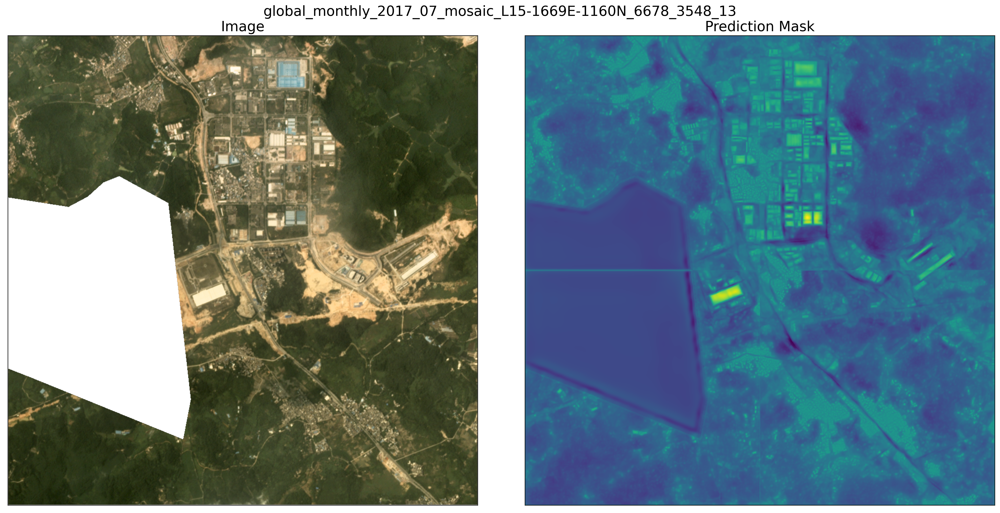

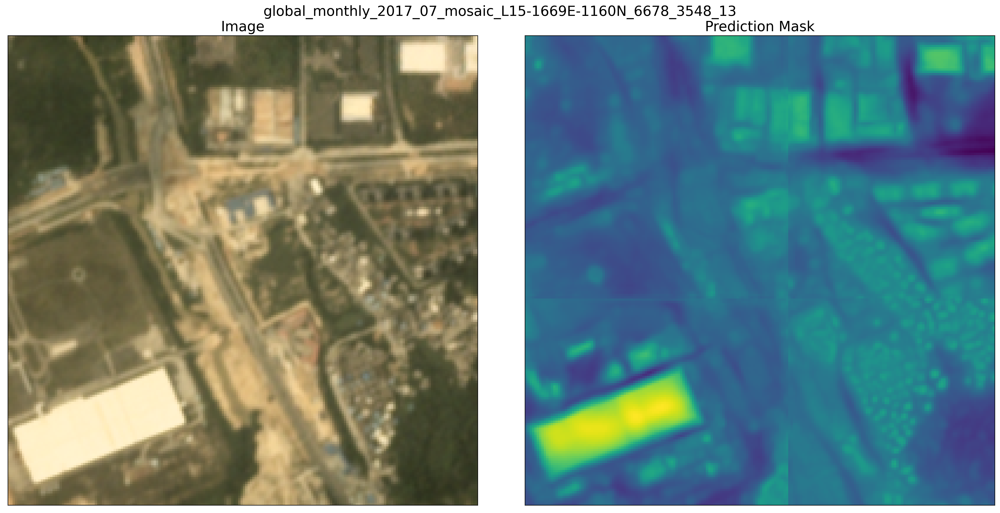

bg_threshold: 0
min_area: 3.5


,geometry,value
0,"POLYGON ((223.000 1.000, 223.000 3.000, 224.00...",255.0
1,"POLYGON ((310.000 1.000, 310.000 2.000, 311.00...",255.0
2,"POLYGON ((354.000 1.000, 354.000 3.000, 356.00...",255.0
3,"POLYGON ((383.000 1.000, 383.000 3.000, 385.00...",255.0
4,"POLYGON ((616.000 1.000, 616.000 2.000, 618.00...",255.0


N geoms: 1312


/home/phone/miniconda3/envs/solaris/lib/python3.7/site-packages/ipykernel_launcher.py:102: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.


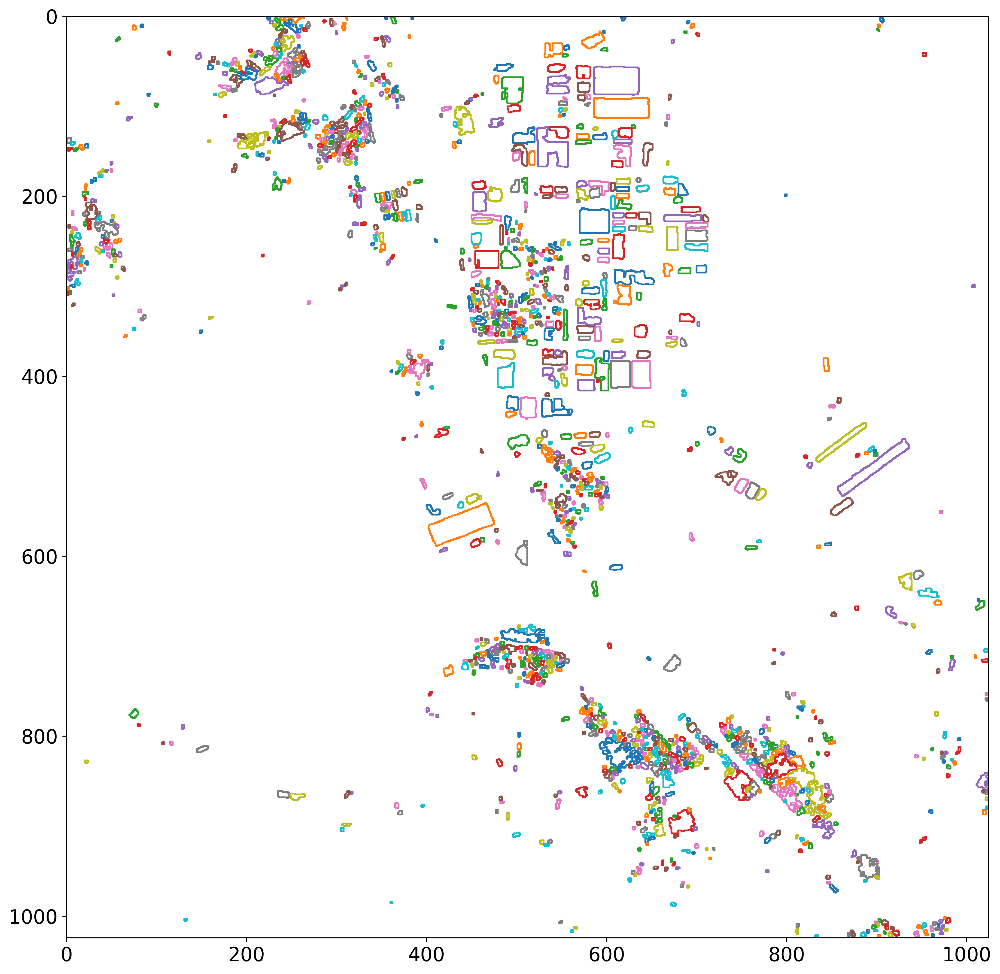

In [15]:
explore_inference_results(baseline_path,aoi)

In [15]:
baseline_valid_path = '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/models/sn7_baseline/baseline_best_epoch14_2.0169999599456787_checkpoint_val_loss.pth'

In [11]:
baseline_valid_losses = (torch.load(baseline_valid_path))

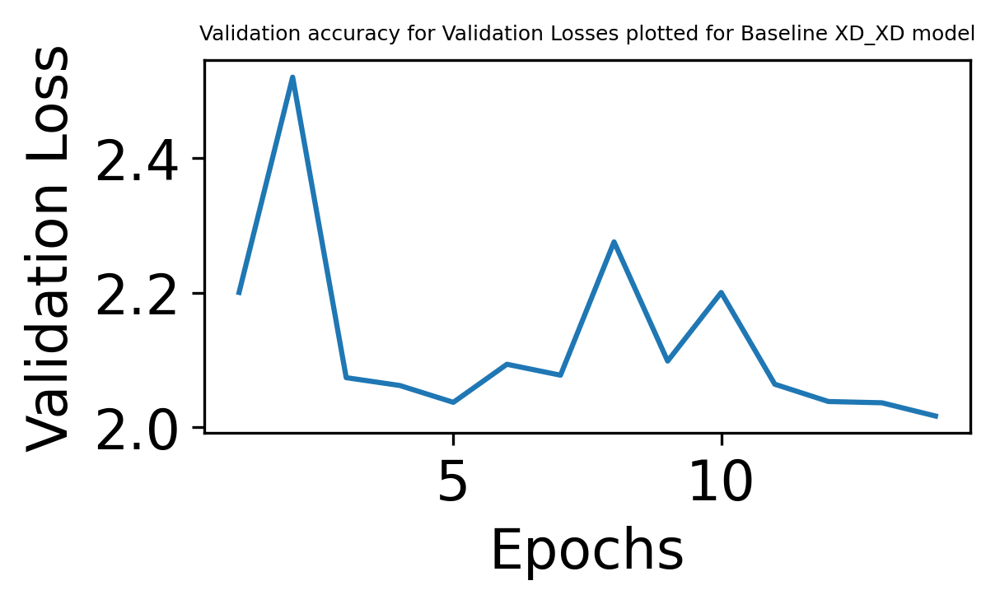

In [37]:
plot_validation_graph(baseline_valid_losses, "Validation Losses plotted for Baseline XD_XD model")

### BASELINE MODEL WITH DICE+BCE LOSS

In [10]:
baseline_dice_bce_path = '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_bce_dice_model'

mask_image.shape: (1024, 1024)
min, max, mean mask image: -6.6316056 0.66022265 -4.102141


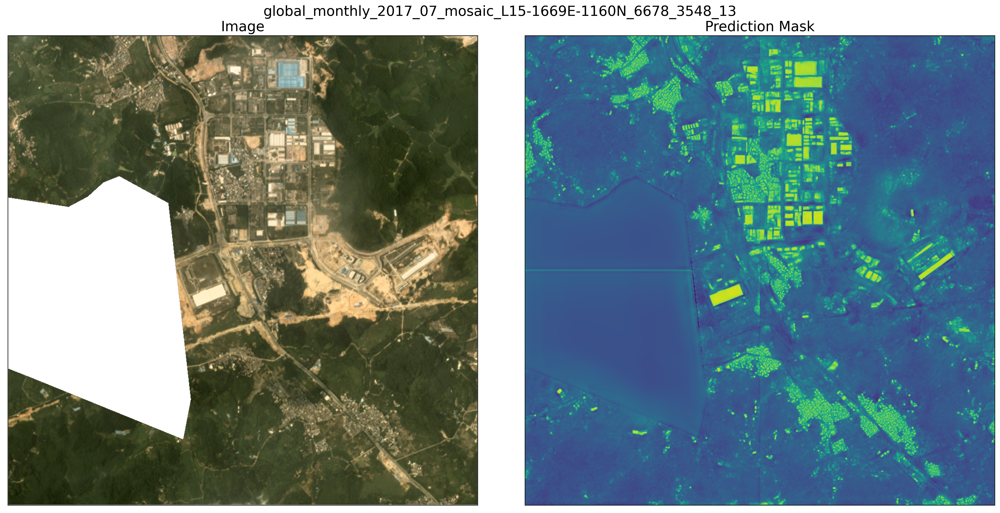

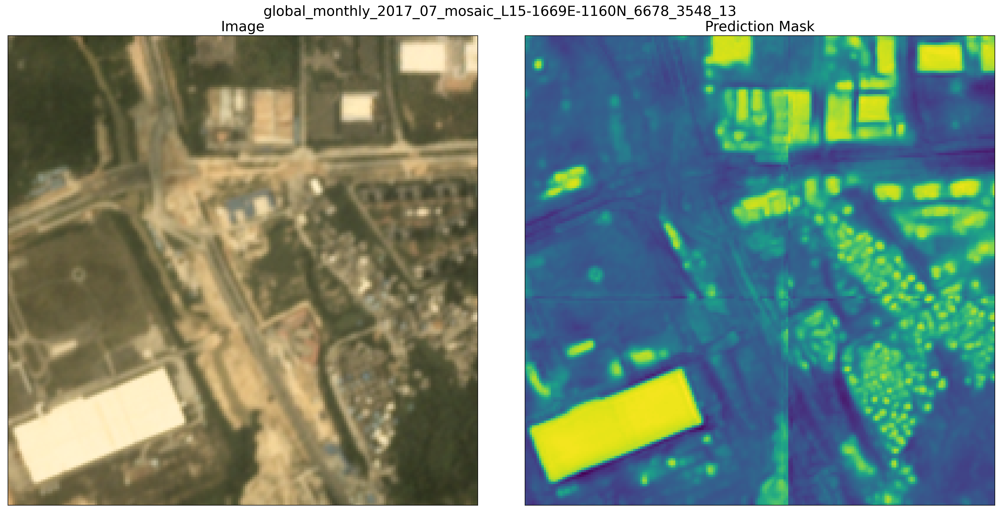

bg_threshold: 0
min_area: 3.5


,geometry,value
0,"POLYGON ((490.000 70.000, 490.000 71.000, 496....",255.0
1,"POLYGON ((498.000 69.000, 498.000 70.000, 497....",255.0
2,"POLYGON ((486.000 72.000, 486.000 76.000, 487....",255.0
3,"POLYGON ((491.000 73.000, 491.000 77.000, 492....",255.0
4,"POLYGON ((511.000 132.000, 511.000 139.000, 51...",255.0


N geoms: 37


/home/phone/miniconda3/envs/solaris/lib/python3.7/site-packages/ipykernel_launcher.py:102: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.


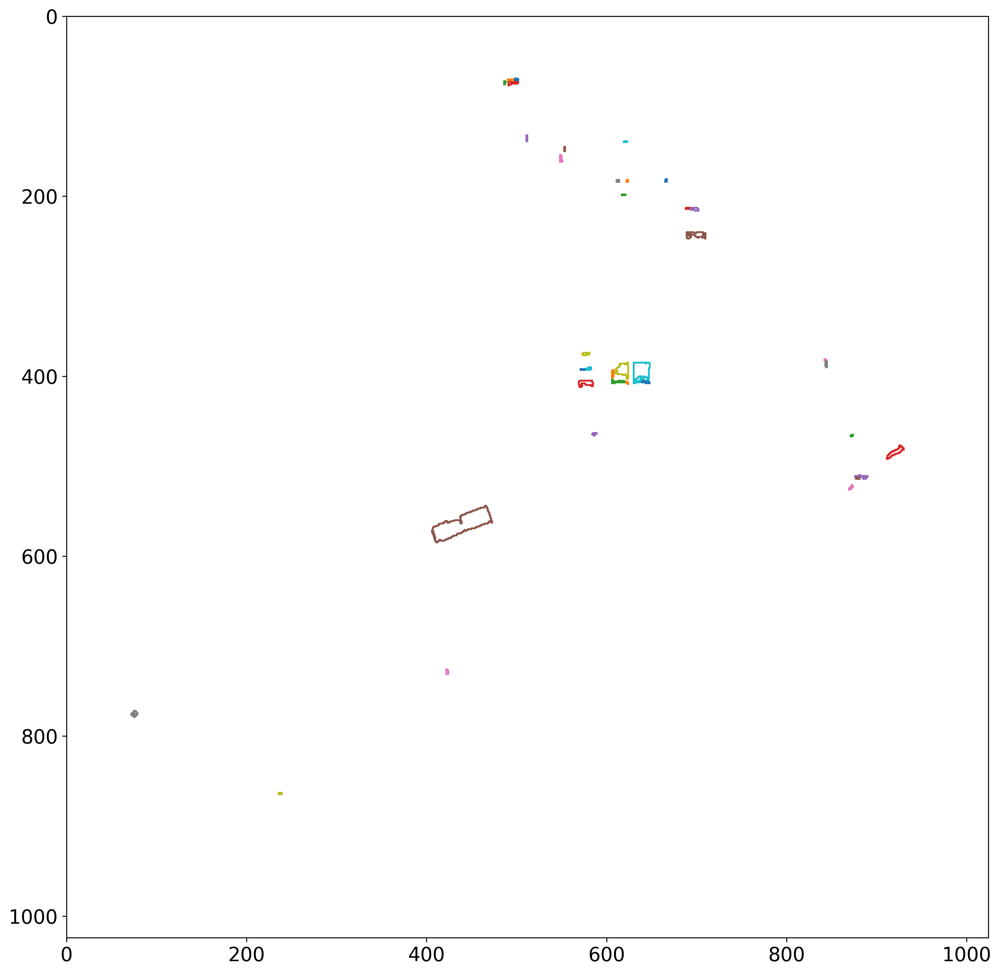

In [11]:
explore_inference_results(baseline_dice_bce_path, aoi)

### VGG13 MODEL

In [8]:
vgg13_path = '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/vgg13_model'

In [23]:
vgg13_val_loss_path =  '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/models/sn7_baseline/vgg13_loss.pth'

In [28]:
valid_loss = torch.load(vgg13_val_loss_path)

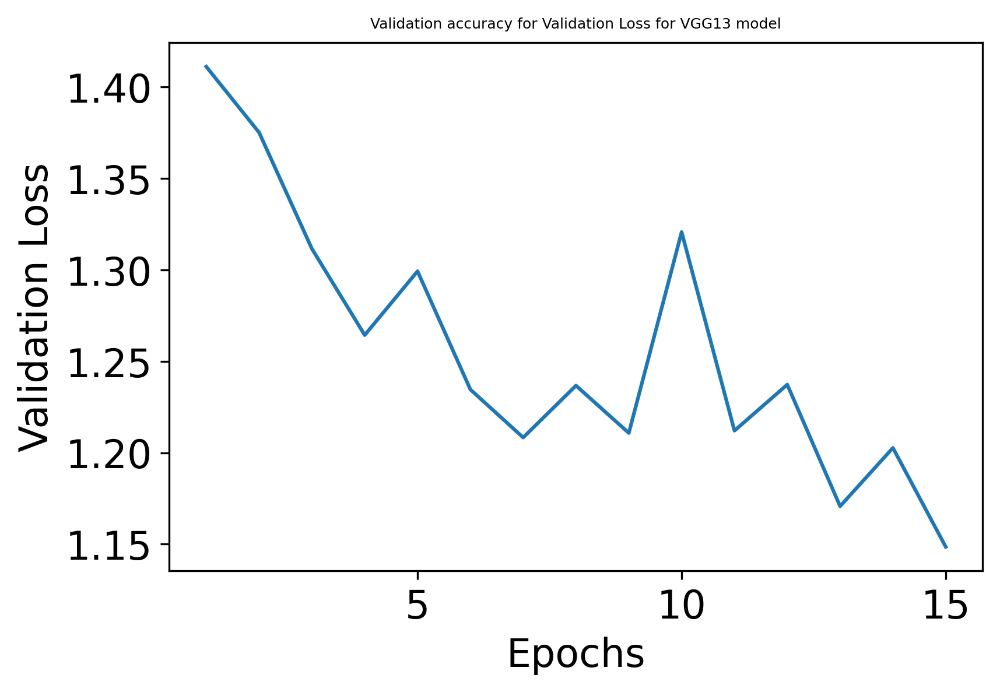

In [29]:
plot_validation_graph_tensor_Ver(valid_loss, "Validation Loss for VGG13 model")

mask_image.shape: (1024, 1024)
min, max, mean mask image: -26.87047 14.832984 -9.487093


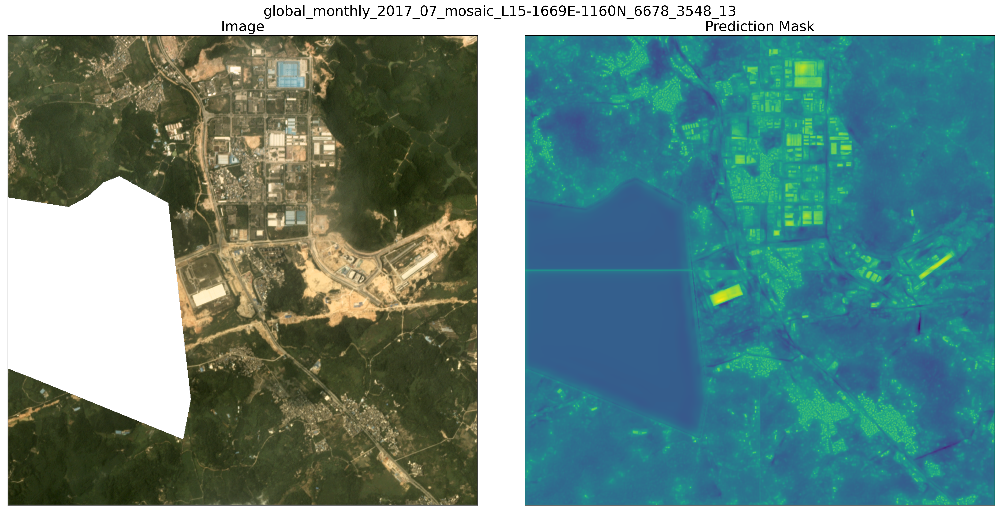

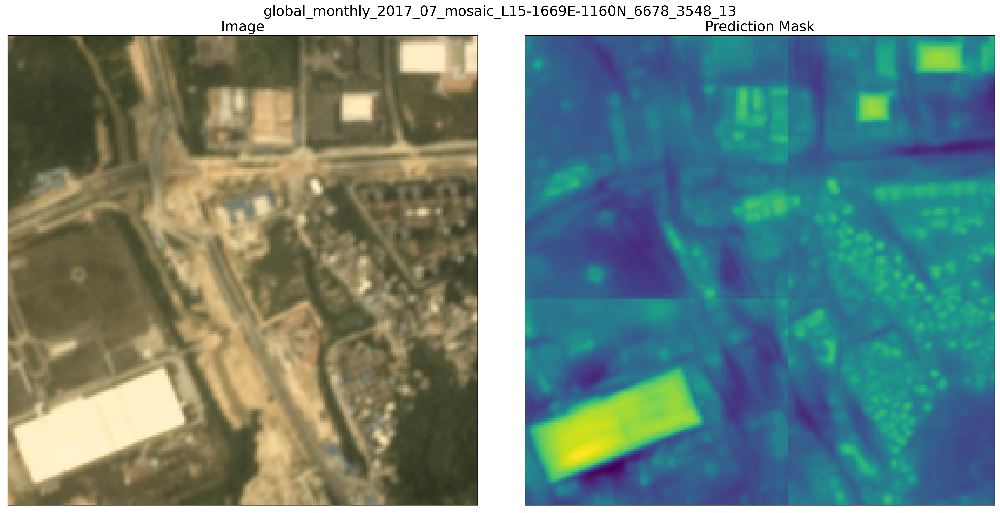

bg_threshold: 0
min_area: 3.5


,geometry,value
0,"POLYGON ((238.000 1.000, 238.000 2.000, 240.00...",255.0
1,"POLYGON ((617.000 1.000, 617.000 2.000, 618.00...",255.0
2,"POLYGON ((360.000 2.000, 360.000 3.000, 361.00...",255.0
3,"POLYGON ((904.000 1.000, 904.000 5.000, 905.00...",255.0
4,"POLYGON ((293.000 4.000, 293.000 9.000, 294.00...",255.0


N geoms: 1268


/home/phone/miniconda3/envs/solaris/lib/python3.7/site-packages/ipykernel_launcher.py:102: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.


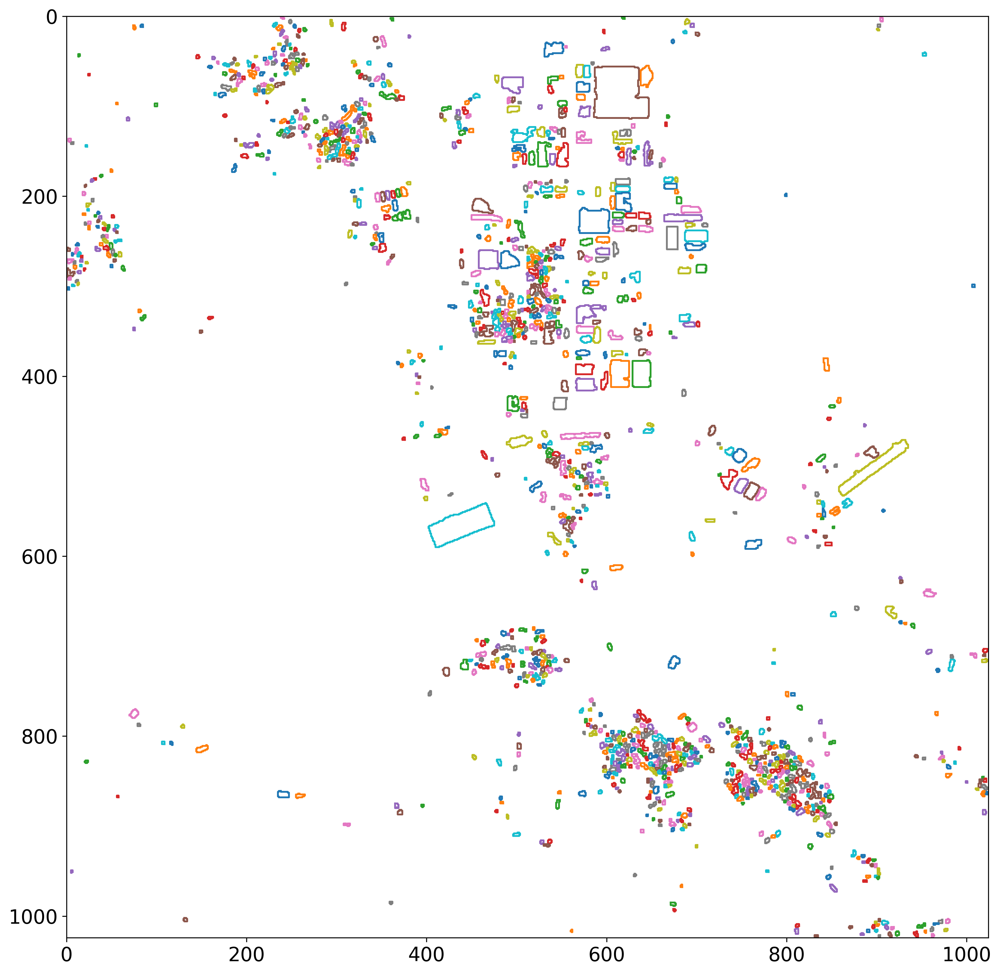

In [9]:
explore_inference_results(vgg13_path, aoi)

### Efficient Net Model

In [10]:
efficientUnet_path = '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/efficientUnet_model'

In [11]:
efficientUnet_val_loss_path =  '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/models/sn7_baseline/efficientUnet_loss.pth'

In [12]:
efficientUnet_valid_loss = torch.load(efficientUnet_val_loss_path)

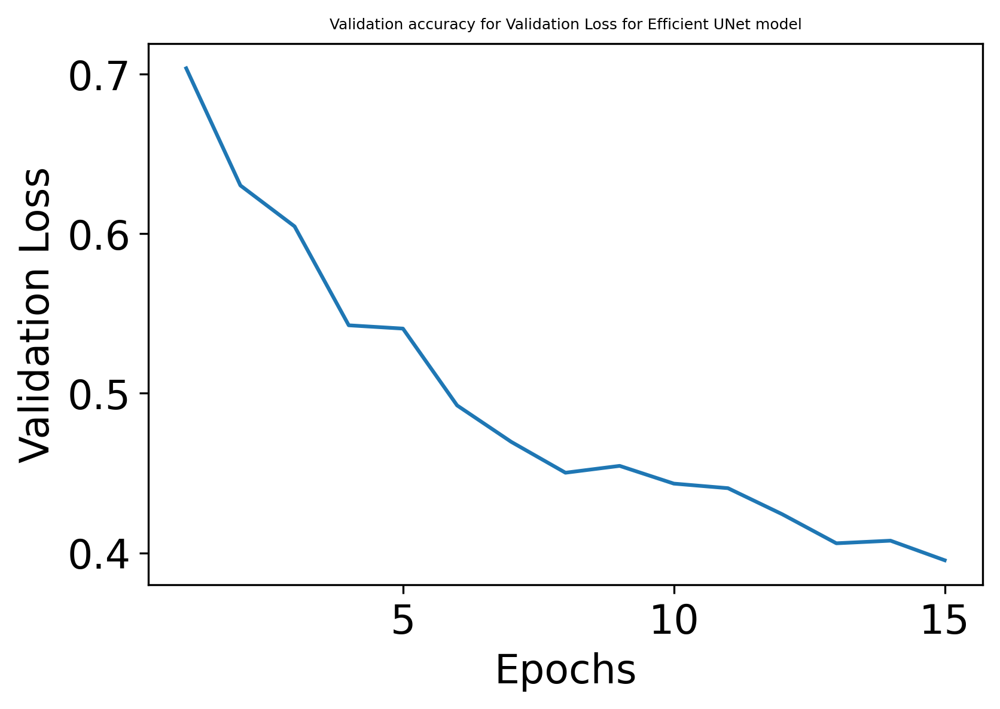

In [21]:
plot_validation_graph_tensor_Ver(efficientUnet_valid_loss, "Validation Loss for Efficient UNet model")

In [30]:
# explore_inference_results(efficientUnet_path, aoi)
# inference could not be run, due to efficientUnet causing out of memory CUDA errors